In [32]:
from PIL import Image
import numpy as np

In [33]:
pict_or = Image.open("Original.bmp")

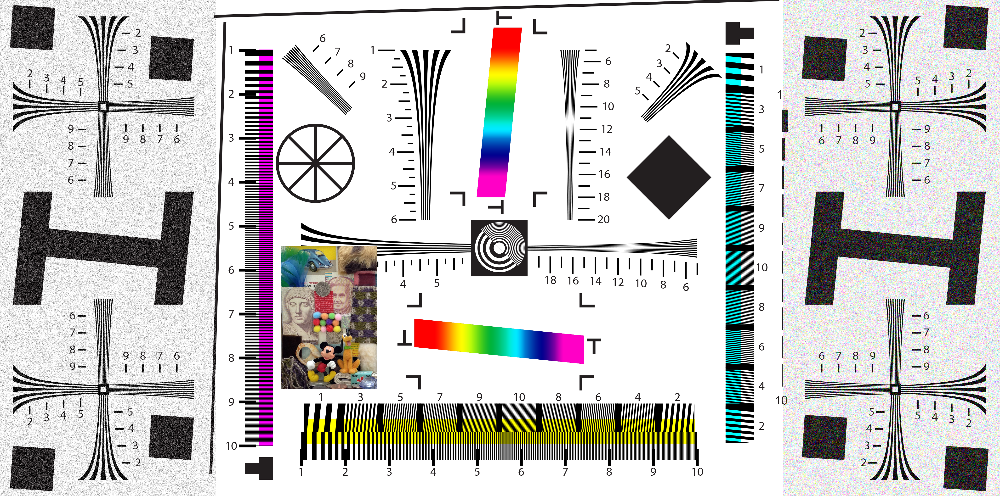

In [102]:
pict_or

In [34]:
pict_or.getpixel((643, 234))

(27, 23, 24)

In [35]:
pict = Image.open("RGB_CFA.bmp")

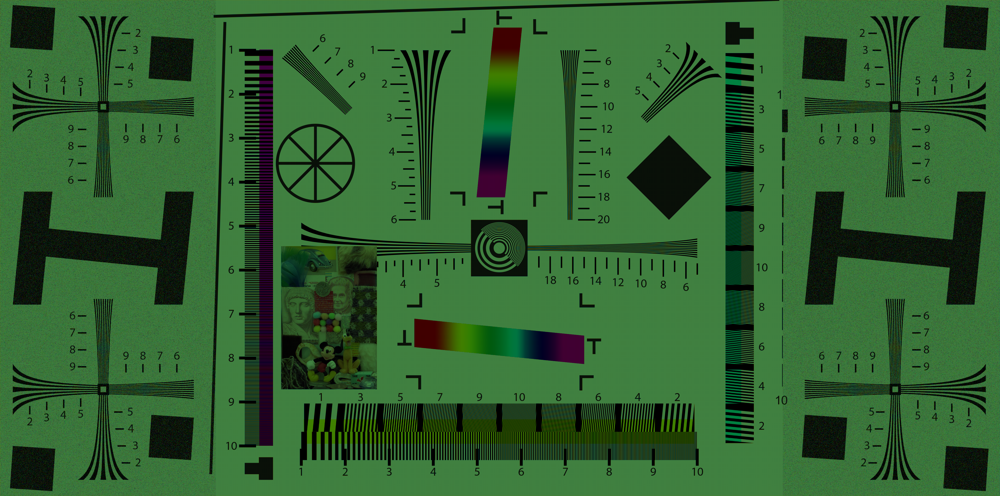

In [ ]:
pict

In [ ]:
pict.getpixel((644, 236))

(189, 0, 0)

In [ ]:
pict.size

(4176, 2073)

In [36]:
pict_np = np.asarray(pict)

In [37]:
pict_np.shape

(2073, 4176, 3)

## Реализация алгоритма PPG

In [38]:
PADDING_SIZE = 2 # увеличим со всех сторон на столько

In [85]:
# несколько полезных и нужных функций

def hueTransit(l1, l2, l3, v1, v3 ):
	if (( l1 < l2 ) and ( l2 < l3 )) or (( l1 > l2 ) and (l2 > l3)):
		return v1 + ( v3 - v1 ) * ( l2 - l1 ) / ( l3 - l1 );
	else:
		return ( v1 + v3 ) / 2 + ( l2 * 2 - l1 - l3 ) / 4


def isBlueOnly(x, y):
	return (( x % 2 != 0) and ( y % 2 != 0 ))

def isRedOnly(x, y):
	return ((x % 2 == 0) and (y % 2 == 0 ))

def isGreenOnly(x, y):
	return (not isBlueOnly(x, y)) and (not isRedOnly(x, y))


def safe_color(x):
	if x > 255:
		return 255
	if x < 0:
		return 0
	return x

def safe_saving(rgb):
	return [safe_color(rgb[0]), safe_color(rgb[1]), safe_color(rgb[2])]

In [40]:
w, h = pict.size

height = h
width = w

#лучше буду работать с массивом сразу, потом переведу в картинку и кропну

image = np.zeros((h + 2*PADDING_SIZE, w + 2*PADDING_SIZE, 3))

for i in range(h):
  for j in range(w):
    image[i + PADDING_SIZE][j + PADDING_SIZE] = pict_np[i][j]

# заполняем справа и слева

for i in range(height + 4):
  image[i][0] = image[i][PADDING_SIZE]
  image[i][1] = image[i][PADDING_SIZE + 1]
  image[i][width + 3] = image[i][width + 3 - PADDING_SIZE]
  image[i][width + 2] = image[i][width + 2 - PADDING_SIZE]

# заполняем сверху и снизу

for x in range(PADDING_SIZE, PADDING_SIZE + width):
  image[0][x] = image[PADDING_SIZE][x]
  image[1][x] = image[PADDING_SIZE + 1][x]
  image[height + 2][x] = image[PADDING_SIZE + height - 2][x]
  image[height + 3][x] = image[PADDING_SIZE + height - 1][x]


In [86]:
def restoreGreenOnBlue():
	for i in range(PADDING_SIZE, PADDING_SIZE+h):
		for j in range(PADDING_SIZE, PADDING_SIZE+w):
			if isBlueOnly( j, i ):
				deltaN = np.abs(image[i][j][2] - image[i - 2][j][2]) * 2 + np.abs(image[i - 1][j][1] - image[i + 1][j][1])
				deltaE = np.abs(image[i][j][2] - image[i][j + 2][2]) * 2 + np.abs(image[i][j - 1][1] - image[i][j + 1][1])
				deltaW = np.abs(image[i][j][2] - image[i][j - 2][2]) * 2 + np.abs(image[i][j - 1][1] - image[i][j + 1][1])
				deltaS = np.abs(image[i][j][2] - image[i + 2][j][2]) * 2 + np.abs(image[i - 1][j][1] - image[i + 1][j][1])
				
				smallestGrad = min(deltaN, min(deltaE, min(deltaW, deltaS)))
				if smallestGrad == deltaN:
					r = image[i][j][0]
					g = (image[i - 1][j][1] * 3 + image[i + 1][j][1] + image[i][j][2] - image[i - 2][j][2]) / 4
					b = image[i][j][2]
				elif smallestGrad == deltaE:
					r = image[i][j][0]
					g = (image[i][j + 1][1] * 3 + image[i][j - 1][1] + image[i][j][2] - image[i][j + 2][2]) / 4
					b = image[i][j][2]
				elif smallestGrad == deltaW:
					r = image[i][j][0]
					g = (image[i][j - 1][1] * 3 + image[i][j + 1][1] + image[i][j][2] - image[i][j - 2][2]) / 4
					b = image[i][j][2]
				elif smallestGrad == deltaS:
					r = image[i][j][0]
					g = (image[i + 1][j][1] * 3 + image[i - 1][j][1] + image[i][j][2] - image[i + 2][j][2]) / 4
					b = image[i][j][2]

				image[i][j] = np.array(safe_saving([r, g, b]))


def restoreGreenOnRed():
	for i in range(PADDING_SIZE, PADDING_SIZE + height):
		for j in range(PADDING_SIZE, PADDING_SIZE + width):
			if isRedOnly(j, i):
				deltaN = np.abs(image[i][j][0] - image[i - 2][j][0]) * 2 + np.abs(image[i - 1][j][1] - image[i + 1][j][1])
				deltaE = np.abs(image[i][j][0] - image[i][j + 2][0]) * 2 + np.abs(image[i][j - 1][1] - image[i][j + 1][1])
				deltaW = np.abs(image[i][j][0] - image[i][j - 2][0]) * 2 + np.abs(image[i][j - 1][1] - image[i][j + 1][1])
				deltaS = np.abs(image[i][j][0] - image[i + 2][j][0]) * 2 + np.abs(image[i - 1][j][1] - image[i + 1][j][1])
		
				smallestGrad = min( deltaN, min( deltaE, min( deltaW, deltaS)))
				
				if smallestGrad == deltaN:
					r = image[i][j][0]
					g = (image[i - 1][j][1] * 3 + image[i + 1][j][1] + image[i][j][0] - image[i - 2][j][0] ) / 4
					b = image[i][j][2]
				elif smallestGrad == deltaE:
					r = image[i][j][0]
					g = (image[i][j + 1][1] * 3 + image[i][j - 1][1] + image[i][j][0] - image[i][j + 2][0]) / 4
					b = image[i][j][2]
				elif smallestGrad == deltaW:
					r = image[i][j][0]
					g = (image[i][j - 1][1] * 3 + image[i][j + 1][1] + image[i][j][0] - image[i][j - 2][0]) / 4
					b = image[i][j][2]
				elif smallestGrad == deltaS:
					r = image[i][j][0]
					g = (image[i + 1][j][1] * 3 + image[i - 1][j][1] + image[i][j][0] - image[i + 2][j][0] ) / 4
					b = image[i][j][2]

				image[i][j] = np.array(safe_saving([r, g, b]))

In [87]:
def computeRedAndBlueAtGreen():
  for i in range(PADDING_SIZE, PADDING_SIZE + height):
    for j in range(PADDING_SIZE, PADDING_SIZE + width):
      if isGreenOnly(j, i):
        if (i % 2 != 0) and (j % 2 == 0 ):
          r = hueTransit(image[i - 1][j][1], image[i][j][1], image[i + 1][j][1], image[i - 1][j][0], image[i + 1][j][0])
          g = image[i][j][1]
          b = hueTransit(image[i][j - 1][1], image[i][j][1], image[i][j + 1][1], image[i][j - 1][2], image[i][j + 1][2])
        else:
          r = hueTransit(image[i][j - 1][1], image[i][j][1], image[i][j + 1][1], image[i][j - 1][0], image[i][j + 1][0])
          g = image[i][j][1]
          b = hueTransit(image[i - 1][j][1], image[i][j][1], image[i + 1][j][1], image[i - 1][j][2], image[i + 1][j][2])
        image[i][j] = np.array(safe_saving([r, g, b]))


def computeBlueAtRed():
  for i in range(PADDING_SIZE, PADDING_SIZE + height):
    for j in range(PADDING_SIZE, PADDING_SIZE + width):
      if isRedOnly(j, i):
        deltaNE = np.abs(image[i - 1][j + 1][2] - image[i + 1][j - 1][2]) + np.abs(image[i - 2][j + 2][0] - image[i][j][0]) + np.abs(image[i][j][0] - image[i + 2][j - 2][0]) \
          + np.abs(image[i - 1][j + 1][1] - image[i][j][1]) + np.abs(image[i][j][1] - image[i + 1][j - 1][1])
        deltaNW = np.abs(image[i - 1][j - 1][2] - image[i + 1][j + 1][2]) + np.abs(image[i - 2][j - 2][0] - image[i][j][0]) + np.abs(image[i][j][0] - image[i + 2][j + 2][0]) \
          + np.abs(image[i - 1][j - 1][1] - image[i][j][1]) + np.abs(image[i][j][1] - image[i + 1][j + 1][1])
        if deltaNE < deltaNW:
          r = image[i][j][0]
          g = image[i][j][1]
          b = hueTransit(image[i - 1][j + 1][1], image[i][j][1], image[i + 1][j - 1][1], image[i - 1][j + 1][2], image[i + 1][j - 1][2])
        else:
          r = image[i][j][0]
          g = image[i][j][1]
          b = hueTransit(image[i - 1][j - 1][1], image[i][j][1], image[i + 1][j + 1][1], image[i - 1][j - 1][2], image[i + 1][j + 1][2])

        image[i][j] = np.array(safe_saving([r, g, b]))


def computeRedAtBlue():
  for i in range(PADDING_SIZE, PADDING_SIZE + height):
    for j in range(PADDING_SIZE, PADDING_SIZE + width):
      if isBlueOnly(j, i):
        deltaNE = np.abs(image[i - 1][j + 1][0] - image[i + 1][j - 1][0]) + np.abs(image[i - 2][j + 2][2] - image[i][j][2]) + np.abs(image[i][j][2] - image[i + 2][j - 2][2]) + np.abs(image[i - 1][j + 1][1] - image[i][j][1]) + np.abs(image[i][j][1] - image[i + 1][j - 1][1])
        deltaNW = np.abs(image[i - 1][j - 1][0] - image[i + 1][j + 1][0]) + np.abs(image[i - 2][j - 2][2] - image[i][j][2]) + np.abs(image[i][j][2] - image[i + 2][j + 2][2]) + np.abs(image[i - 1][j - 1][1] - image[i][j][1]) + np.abs(image[i][j][1] - image[i + 1][j + 1][1])
        if deltaNE < deltaNW:
          r = hueTransit(image[i - 1][j + 1][1], image[i][j][1], image[i + 1][j - 1][1], image[i - 1][j + 1][0], image[i + 1][j - 1][0])
          g = image[i][j][1]
          b = image[i][j][2]
        else:
          r = hueTransit(image[i - 1][j - 1][1], image[i][j][1], image[i + 1][j + 1][1], image[i - 1][j - 1][0], image[i + 1][j + 1][0])
          g = image[i][j][1]
          b = image[i][j][2]
          
        image[i][j] = np.array(safe_saving([r, g, b]))

In [88]:
def restoreGreen(): #восстанавливаем зеленый
  restoreGreenOnRed();
  restoreGreenOnBlue();

def restoreBlueAndRed(): #восстанавливаем синий и красный
  computeRedAndBlueAtGreen();
  computeBlueAtRed();
  computeRedAtBlue();


def make_PPG(): # алгоритм PPG
  restoreGreen()
  print("Green has been restored")
  restoreBlueAndRed()
  print("Blue and red have been restored")

In [89]:
%%time

make_PPG()

Green has been restored
Blue and red have been restored
CPU times: user 5min 54s, sys: 1.89 s, total: 5min 56s
Wall time: 5min 53s


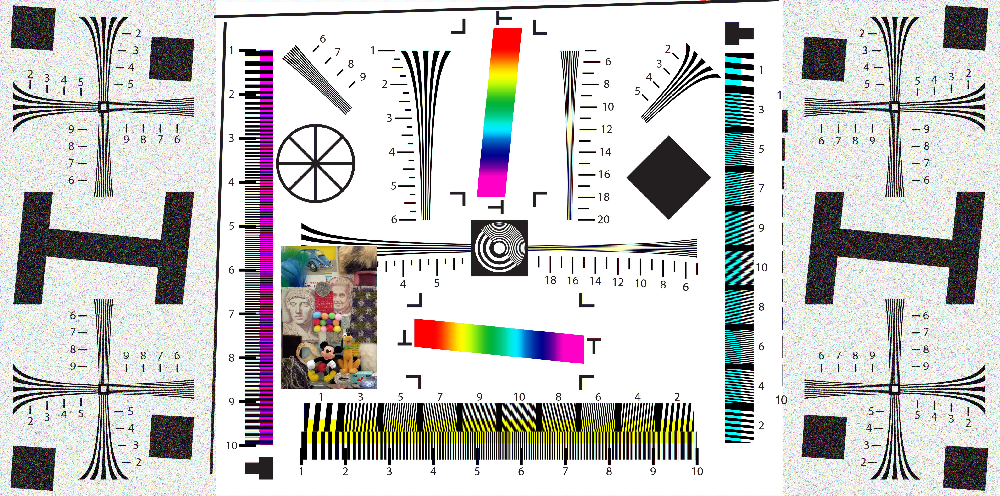

In [93]:
res_img = Image.fromarray(image.astype(np.uint8))

res_img

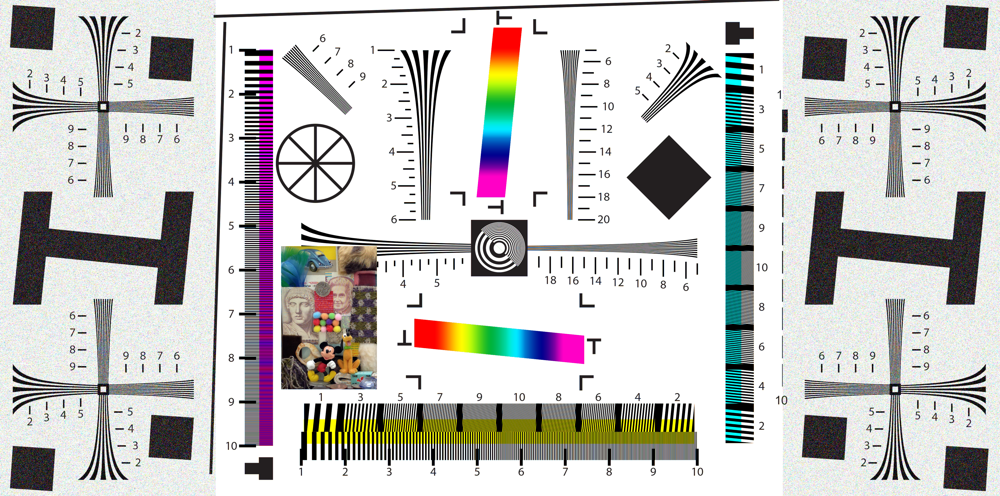

In [95]:
res_img_croped = res_img.crop((PADDING_SIZE, PADDING_SIZE, w+PADDING_SIZE, h+PADDING_SIZE)) # убираем границы, которые добавляли
res_img_croped

In [97]:
res_img_croped.save("result_image_png", "PNG") # сохранили получившийся результат

### Подсчитаем метрику PSNR

In [100]:
def PSNR(original, compressed): 
    mse = np.mean((original - compressed) ** 2)
    if(mse == 0):  # MSE is zero means no noise is present in the signal . Therefore PSNR have no importance. 
        print("no noise is present in the signal")
        return 100
    max_pixel = 255.0
    psnr = 10 * np.log10((max_pixel**2) / mse) 
    return psnr 

In [101]:
psnr = PSNR(np.asarray(pict_or), np.asarray(res_img_croped))
print("Значение метрики PSNR на оригинальном изображении и созданном нами: ", psnr)

Значение метрики PSNR на оригинальном изображении и созданном нами:  33.736481340982834


__Результаты:__  Реализованный мной алгоритм PPG смог довольно неплохо восстановить исходное изображение, разрешение снижается не сверх сильно, значение метрики PSNR получилось равным 33.74. На работу самой функции make_PPG() , в которой и выполняется сам алгоритм(с некоторыми вспомогательными функциями) ушло 5min 53sec или же 0.041 мсек/пиксель = 41005 мсек/мегапиксель. Предобработка картинки, а именно добавление padding-а со всех сторон от картинки - в этом времени не учитывались